In [1]:
require(data.table)
library(shades)
require(ggrepel)
require(plyr)
library(scales)

Loading required package: data.table

Loading required package: ggrepel

Loading required package: ggplot2

Loading required package: plyr



In [2]:
#HGMD mutations are currently filtered to the 138 mutations with strongest impact
#due to licensing retrictions. We will update this if we obtain proper agreement to 
#release full data

anno = fread('/home/sonic/sei/sei-manuscript/pathogenic_mutations/sei_data/hgmd_above1.1_anno.tsv') # HGMD data
refproj = fread('/home/sonic/sei/sei-manuscript/pathogenic_mutations/sei_data/hgmd_above1.1_refproj.tsv') # HGMD mutation ref allele에 대한 sequence class score
altproj = fread('/home/sonic/sei/sei-manuscript/pathogenic_mutations/sei_data/hgmd_above1.1_altproj.tsv') # HGMD mutation alt allele에 대한 sequence class score

reflouvain = fread('/home/sonic/sei/sei-manuscript/pathogenic_mutations/sei_data/hgmd_above1.1_seqclass_refanno.tsv') # ref allele에 대한 predicted sequnce class
cnames = fread('/home/sonic/sei/sei-manuscript/resources/cnames.tsv')

In [3]:
anno$C_reflouvain= as.numeric(reflouvain$V4) # ref allele의 sequence class column 추가
anno$C_diff = apply(abs(data.matrix(altproj-refproj)),1,which.max)-1 # alt allele의 predicted sequence class column 추가
anno$diff_C_diff = data.matrix((altproj-refproj))[cbind(1:dim(refproj)[1],anno$C_diff+1)] 
anno$diff_C_reflouvain = data.matrix((altproj-refproj))[cbind(1:dim(refproj)[1],anno$C_reflouvain+1)]

#mutation sequence class assignment
anno$C_final = anno$C_reflouvain
anno$diff_C_final = anno$diff_C_reflouvain
ind = which( (abs(anno$diff_C_diff) > abs(anno$diff_C_reflouvain) + 1) &(abs(anno$diff_C_diff) > 2.5*abs(anno$diff_C_reflouvain) ) )
anno$C_final[ind] = anno$C_diff[ind]
anno$diff_C_final[ind] = anno$diff_C_diff[ind]
head(anno)

# C_final : sequence class with maximum score
# diff_C_final : prediction score having maximum absolute value

chr,pos,ref,alt,gene,pheno,C_reflouvain,C_diff,diff_C_diff,diff_C_reflouvain,C_final,diff_C_final
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,155271258,T,C,PKLR,Pyruvate kinase deficiency,38,38,-8.426062,-8.4260618,38,-8.426062
1,155271259,C,G,PKLR,Pyruvate kinase deficiency,38,38,-8.183721,-8.1837208,38,-8.183721
1,196620941,C,T,CFH,"Haemolytic uraemic syndrome, atypical",9,9,-3.475348,-3.4753483,9,-3.475348
1,228337558,A,G,GJC2,Pelizaeus-Merzbacher-like disease,9,5,-2.606251,-1.0424582,5,-2.606251
1,228337561,A,G,GJC2,Pelizaeus-Merzbacher-like disease,9,5,-2.588826,-0.8652728,5,-2.588826
2,73114549,G,A,SPR,"Dystonia, dopa-responsive",25,27,-1.280454,-0.2426899,27,-1.280454


In [5]:
case_sei = fread("/data2/sei-framework/output/Korean_ASD_WGS/hg38/cases/max_sequence_class_score.tsv")
head(case_sei)

chrom,pos,id,ref,alt,max_seqclass,seqclass_max_absdiff,seqclass_pred_score
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>
chr1,101078,"chr1:101078:C:T;SAMPLE=30253.p;CONSEQUENCE=intron_variant,non_coding_transcript_variant",C,T,L4 Low signal,0.01311026,-0.01311026
chr1,280250,"chr1:280250:G:A;SAMPLE=18183.p;CONSEQUENCE=intron_variant,non_coding_transcript_variant",G,A,L4 Low signal,0.09038948,-0.09038948
chr1,827260,chr1:827260:C:T;SAMPLE=9973.p;CONSEQUENCE=non_coding_transcript_exon_variant,C,T,E4 Multi-tissue,1.00702073,-1.00702073
chr1,905305,"chr1:905305:G:GT;SAMPLE=20693.p;CONSEQUENCE=intron_variant,non_coding_transcript_variant",G,GT,L5 Low signal,0.42895604,0.42895604
chr1,923187,chr1:923187:T:C;SAMPLE=20693.p;CONSEQUENCE=upstream_gene_variant,T,C,CTCF CTCF-Cohesin,0.46000860,-0.46000860
chr1,1059429,chr1:1059429:G:A;SAMPLE=19083.p;CONSEQUENCE=upstream_gene_variant,G,A,CTCF CTCF-Cohesin,1.26608838,-1.26608838


In [8]:
strsplit(case_sei$max_seqclass, " ")

[[1]]
[1] "L4"     "Low"    "signal"

[[2]]
[1] "L4"     "Low"    "signal"

[[3]]
[1] "E4"           "Multi-tissue"

[[4]]
[1] "L5"     "Low"    "signal"

[[5]]
[1] "CTCF"         "CTCF-Cohesin"

[[6]]
[1] "CTCF"         "CTCF-Cohesin"

[[7]]
[1] "E4"           "Multi-tissue"

[[8]]
[1] "CTCF"         "CTCF-Cohesin"

[[9]]
[1] "PC3"      "Polycomb"

[[10]]
[1] "PC1"             "Polycomb"        "/"               "Heterochromatin"

[[11]]
[1] "TN4"           "Transcription"

[[12]]
[1] "E9"        "Liver"     "/"         "Intestine"

[[13]]
[1] "PC2"      "Weak"     "Polycomb"

[[14]]
[1] "E5"          "B-cell-like"

[[15]]
[1] "E5"          "B-cell-like"

[[16]]
[1] "TN2"           "Transcription"

[[17]]
[1] "TN1"           "Transcription"

[[18]]
[1] "TN3"           "Transcription"

[[19]]
[1] "TF3"   "FOXA1" "/"     "AR"    "/"     "ESR1" 

[[20]]
[1] "E11"    "T-cell"

[[21]]
[1] "TN4"           "Transcription"

[[22]]
[1] "TN1"           "Transcription"

[[23]]
[1] "L3"     "Low"    "signal"

[[24]]
[1] "E11"    "T-cell"

[[25]]
[1] "E4"           "Multi-tissue"

[[26]]
[1] "E8"           "Weak"         "multi-tissue"

[[27]]
[1] "TN4"           "Transcription"

[[28]]
[1] "TN1"           "Transcription"

[[29]]
[1] "PC2"      "Weak"     "Polycomb"

[[30]]
[1] "E1"   "Stem" "cell"

[[31]]
[1] "E9"        "Liver"     "/"         "Intestine"

[[32]]
[1] "CTCF"         "CTCF-Cohesin"

[[33]]
[1] "TN4"           "Transcription"

[[34]]
[1] "L4"     "Low"    "signal"

[[35]]
[1] "TN4"           "Transcription"

[[36]]
[1] "TN4"           "Transcription"

[[37]]
[1] "E9"        "Liver"     "/"         "Intestine"

[[38]]
[1] "HET2"            "Heterochromatin"

[[39]]
[1] "HET1"            "Heterochromatin"

[[40]]
[1] "E4"           "Multi-tissue"

[[41]]
[1] "L3"     "Low"    "signal"

[[42]]
[1] "E4"           "Multi-tissue"

[[43]]
[1] "L4"     "Low"    "signal"

[[44]]
[1] "PC1"             "Polycomb"        "/"               "Heterochromatin"

[[45]]
[1] "E4"           "Multi-tissue"

[[46]]
[1] "CTCF"         "CTCF-Cohesin"

[[47]]
[1] "TF5" "AR" 

[[48]]
[1] "TN4"           "Transcription"

[[49]]
[1] "E9"        "Liver"     "/"         "Intestine"

[[50]]
[1] "E9"        "Liver"     "/"         "Intestine"

[[51]]
[1] "HET3"            "Heterochromatin"

[[52]]
[1] "TN1"           "Transcription"

[[53]]
[1] "PC4"      "Polycomb" "/"        "Bivalent" "stem"     "cell"     "Enh"     

[[54]]
[1] "PC2"      "Weak"     "Polycomb"

[[55]]
[1] "L4"     "Low"    "signal"

[[56]]
[1] "L5"     "Low"    "signal"

[[57]]
[1] "TN4"           "Transcription"

[[58]]
[1] "CTCF"         "CTCF-Cohesin"

[[59]]
[1] "CTCF"         "CTCF-Cohesin"

[[60]]
[1] "E8"           "Weak"         "multi-tissue"

[[61]]
[1] "PC3"      "Polycomb"

[[62]]
[1] "HET1"            "Heterochromatin"

[[63]]
[1] "PC2"      "Weak"     "Polycomb"

[[64]]
[1] "L4"     "Low"    "signal"

[[65]]
[1] "E10"   "Brain"

[[66]]
[1] "PC2"      "Weak"     "Polycomb"

[[67]]
[1] "PC4"      "Polycomb" "/"        "Bivalent" "stem"     "cell"     "Enh"     

[[68]]
[1] "PC2"      "Weak"     "Polycomb"

[[69]]
[1] "E10"   "Brain"

[[70]]
[1] "PC3"      "Polycomb"

[[71]]
[1] "E10"   "Brain"

[[72]]
[1] "E4"           "Multi-tissue"

[[73]]
[1] "P"        "Promoter"

[[74]]
[1] "TF5" "AR" 

[[75]]
[1] "E6"         "Weak"       "epithelial"

[[76]]
[1] "L5"     "Low"    "signal"

[[77]]
[1] "TN4"           "Transcription"

[[78]]
[1] "E7"         "Monocyte"   "/"          "Macrophage"

[[79]]
[1] "PC1"             "Polycomb"        "/"               "Heterochromatin"

[[80]]
[1] "HET1"            "Heterochromatin"

[[81]]
[1] "TF2"   "CEBPB"

[[82]]
[1] "TF4"  "OTX2"

[[83]]
[1] "HET2"            "Heterochromatin"

[[84]]
[1] "PC2"      "Weak"     "Polycomb"

[[85]]
[1] "TF4"  "OTX2"

[[86]]
[1] "E6"         "Weak"       "epithelial"

[[87]]
[1] "PC3"      "Polycomb"

[[88]]
[1] "TN1"           "Transcription"

[[89]]
[1] "TN1"           "Transcription"

[[90]]
[1] "L4" 

In [ ]:
case_sei$sequence_class = 

In [6]:
cnames

vis_order,ID,name,index,group
<int>,<chr>,<chr>,<int>,<chr>
1,E5,B-cell-like,12,E
2,E7,Monocyte / Macrophage,16,E
3,E11,T-cell,36,E
4,E12,Erythroblast-like,38,E
5,E1,Stem cell,5,E
6,E10,Brain,30,E
7,E3,Brain / Melanocyte,7,E
8,E9,Liver / Intestine,26,E
9,E2,Multi-tissue,6,E


In [4]:
#This partially reproduces Figure 4 including only mutations with sequence class-level variant effect score > 1.1
plotdata_group=data.frame(sort(table(anno$C_final),decreasing = T)) # table in R -> aggregate function of count // like value_counts() in dataframe of python 
colnames(plotdata_group)[1] = 'index'

head(plotdata_group)

,index,Freq
,<fct>,<int>
1,25,53
2,38,22
3,26,19
4,27,13
5,19,9
6,9,6


In [62]:
#order the variants
plotdata = anno
plotdata$cind =  -match(plotdata$C_final, plotdata_group$index) # match in R -> notice order of first argument(vector) on secode argument(vector)
plotdata = plotdata[order(cind, chr, pos)]
plotdata$ind=1:dim(plotdata)[1]
head(plotdata)

# cind : class의 index * (-1)
# ind : index -> 그냥 순서대로

chr,pos,ref,alt,gene,pheno,C_reflouvain,C_diff,diff_C_diff,diff_C_reflouvain,C_final,diff_C_final,cind,ind
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>
X,79270181,G,A,TBX22,Cleft palate,37,37,-3.462627,-3.46262683,37,-3.462627,-11,1
11,5248329,T,G,HBB,Beta thalassaemia,26,13,2.674466,-0.07513235,13,2.674466,-10,2
X,37639266,C,T,CYBB,Chronic granulomatous disease,12,16,-3.512266,-1.30158962,16,-3.512266,-9,3
X,37639267,C,T,CYBB,Chronic granulomatous disease,12,16,-3.113659,-0.76073126,16,-3.113659,-9,4
X,154251045,A,G,F8,Haemophilia A,16,16,-1.162220,-1.16221999,16,-1.162220,-9,5
X,154251048,A,T,F8,Haemophilia A,16,38,-2.319208,-2.24696841,16,-2.246968,-9,6


In [63]:
#make disease label appear only once if multiple mutations share the same for the same cluster
plotdata$pheno_filtered=""
plotdata[,max_C_final := max(abs(diff_C_final)),by=list(pheno,C_final)]
plotdata[abs(diff_C_final)==max_C_final, pheno_filtered:=paste(pheno,gene,sep=', ')]
head(plotdata)

# pheno_filtered : phenotype, gene

chr,pos,ref,alt,gene,pheno,C_reflouvain,C_diff,diff_C_diff,diff_C_reflouvain,C_final,diff_C_final,cind,ind,pheno_filtered,max_C_final
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<dbl>
X,79270181,G,A,TBX22,Cleft palate,37,37,-3.462627,-3.46262683,37,-3.462627,-11,1,"Cleft palate, TBX22",3.462627
11,5248329,T,G,HBB,Beta thalassaemia,26,13,2.674466,-0.07513235,13,2.674466,-10,2,"Beta thalassaemia, HBB",2.674466
X,37639266,C,T,CYBB,Chronic granulomatous disease,12,16,-3.512266,-1.30158962,16,-3.512266,-9,3,"Chronic granulomatous disease, CYBB",3.512266
X,37639267,C,T,CYBB,Chronic granulomatous disease,12,16,-3.113659,-0.76073126,16,-3.113659,-9,4,,3.512266
X,154251045,A,G,F8,Haemophilia A,16,16,-1.162220,-1.16221999,16,-1.162220,-9,5,,2.246968
X,154251048,A,T,F8,Haemophilia A,16,38,-2.319208,-2.24696841,16,-2.246968,-9,6,"Haemophilia A, F8",2.246968


In [64]:
plotdata_group=data.table(plotdata_group)
plotdata_group$label = cnames$ID[match(plotdata_group$index, cnames$index)]
plotdata_group$names = cnames$name[match(plotdata_group$index, cnames$index)]
plotdata_group$group_label = cnames$group[match(plotdata_group$index, cnames$index)]
plotdata_group$group_label = factor(plotdata_group$group_label,levels=c('E','CTCF','P','TF','HET','PC','TN','L'))

head(plotdata_group)

# label : sequence class
# group_label : group name

index,Freq,label,names,group_label
<fct>,<int>,<chr>,<chr>,<fct>
25,53,P,Promoter,P
38,22,E12,Erythroblast-like,E
26,19,E9,Liver / Intestine,E
27,13,CTCF,CTCF-Cohesin,CTCF
19,9,TF3,FOXA1 / AR / ESR1,TF
9,6,E4,Multi-tissue,E


In [65]:
plotdata$group_label = plotdata_group$group_label[match(plotdata$C_final, plotdata_group$index)]
plotdata$label = plotdata_group$label[match(plotdata$C_final, plotdata_group$index)]
plotdata$names = plotdata_group$names[match(plotdata$C_final, plotdata_group$index)]

shift=3
plotdata[cind > -15, newind:=(ind-min(ind))/(max(ind)-min(ind))*(max(ind)-min(ind)-shift*2)+min(ind)+shift ,by=cind]
plotdata[cind <= -15, newind:=as.double(ind)]
head(plotdata)

# names : detail of sequence class?

chr,pos,ref,alt,gene,pheno,C_reflouvain,C_diff,diff_C_diff,diff_C_reflouvain,C_final,diff_C_final,cind,ind,pheno_filtered,max_C_final,group_label,label,names,newind
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>,<dbl>,<fct>,<chr>,<chr>,<dbl>
X,79270181,G,A,TBX22,Cleft palate,37,37,-3.462627,-3.46262683,37,-3.462627,-11,1,"Cleft palate, TBX22",3.462627,TF,TF5,AR,NaN
11,5248329,T,G,HBB,Beta thalassaemia,26,13,2.674466,-0.07513235,13,2.674466,-10,2,"Beta thalassaemia, HBB",2.674466,E,E6,Weak epithelial,NaN
X,37639266,C,T,CYBB,Chronic granulomatous disease,12,16,-3.512266,-1.30158962,16,-3.512266,-9,3,"Chronic granulomatous disease, CYBB",3.512266,E,E7,Monocyte / Macrophage,6
X,37639267,C,T,CYBB,Chronic granulomatous disease,12,16,-3.113659,-0.76073126,16,-3.113659,-9,4,,3.512266,E,E7,Monocyte / Macrophage,5
X,154251045,A,G,F8,Haemophilia A,16,16,-1.162220,-1.16221999,16,-1.162220,-9,5,,2.246968,E,E7,Monocyte / Macrophage,4
X,154251048,A,T,F8,Haemophilia A,16,38,-2.319208,-2.24696841,16,-2.246968,-9,6,"Haemophilia A, F8",2.246968,E,E7,Monocyte / Macrophage,3


In [66]:
scale_fill_Publication <- function(...){
      #discrete_scale("fill","Publication",manual_pal(values = c("#386cb0","#fdb462","#7fc97f","#ef3b2c","#984ea3","#662506","#a6cee3","#fb9a99","#dddddd")), ...)
      discrete_scale("fill","Publication",manual_pal(values = c("#984ef3","#fdb462","#ef3b2c","#386cb0","#662506","#a6cee3","#fb9a99","#dddddd")), ...)


}
scale_color_Publication <- function(...){
      #discrete_scale("fill","Publication",manual_pal(values = c("#386cb0","#fdb462","#7fc97f","#ef3b2c","#984ea3","#662506","#a6cee3","#fb9a99","#dddddd")), ...)
      discrete_scale("color","Publication",manual_pal(values = brightness(c("#984ef3","#fdb462","#ef3b2c","#386cb0","#662506","#a6cee3","#fb9a99","#dddddd"),0.6)), ...)
}

Warning message:
“Removed 2 rows containing missing values (geom_point).”
Warning message:
“Removed 1 rows containing missing values (geom_text_repel).”
Warning message:
“Removed 1 rows containing missing values (geom_text_repel).”
Warning message:
“ggrepel: 27 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“Removed 2 rows containing missing values (geom_point).”
Warning message:
“Removed 1 rows containing missing values (geom_text_repel).”
Warning message:
“Removed 1 rows containing missing values (geom_text_repel).”


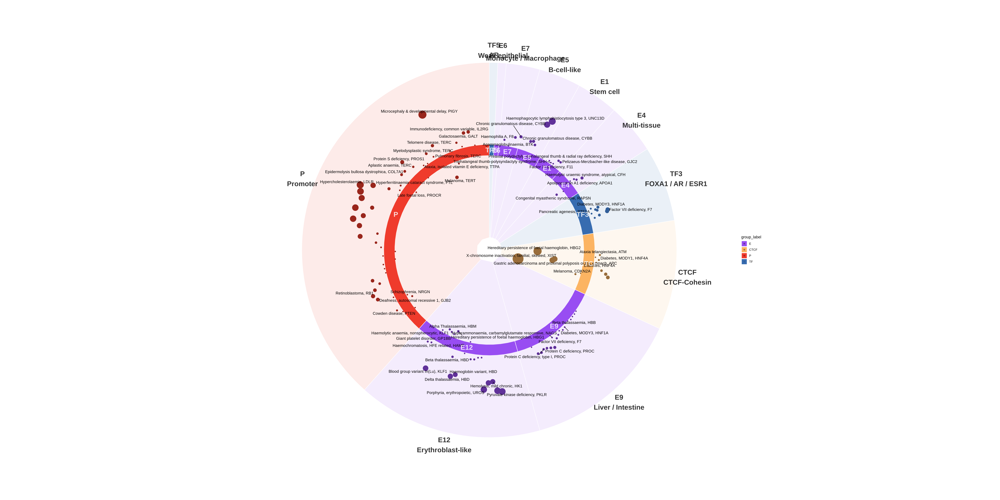

In [67]:
options(repr.plot.width = 40, repr.plot.height = 20, repr.plot.res = 200)

ggplot() +
  geom_bar(aes(x = 0, y = Freq, group = index, fill=group_label),width=2.2,stat = "identity", color = "white",data=plotdata_group) +
  geom_bar(aes(x = 0, y = Freq, group = index, fill=group_label),width=35, alpha=I(0.1),stat = "identity", color = "white",data=plotdata_group) +
  coord_polar(theta = "y", start = 0)+
  theme_void()+
  xlim(-20, 20)+
geom_point(aes(y=newind, x=-diff_C_final,color=group_label,size=I(abs(diff_C_final))), data=plotdata[abs(diff_C_final)>0.,])+
geom_text_repel(aes(y=newind, x=-(diff_C_final),label=pheno_filtered), nudge_x = -0.3, data=plotdata[diff_C_final>1.3,],size=4.,force=6)+
geom_text_repel(aes(y=newind, x=-(diff_C_final),label=pheno_filtered), nudge_x = 0.3, data=plotdata[diff_C_final< -1.3,],size=4.,force=6)+
geom_text(aes(x = 0, y = rev(cumsum(rev(Freq)))-Freq/2, label = label), size=7, alpha=0.8, color = "white", fontface = "bold", data=plotdata_group)+
geom_text(aes(x = 20, y = rev(cumsum(rev(Freq)))-Freq/2, label = paste0(label,'\n',names)), size=7, alpha=0.8, color = "black", fontface = "bold", data=plotdata_group)+
scale_fill_Publication()+scale_color_Publication()

ggsave('./figures/hgmd.seqclass.effects.pdf', width=40, height = 20, dpi = 200, device=cairo_pdf)

In [68]:
output_table = plotdata[abs(plotdata$diff_C_final)>1.1, c("chr","pos","ref","alt","gene","pheno","label","names","diff_C_final"),with=F]
colnames(output_table)<-c("Chr","Pos","REF","ALT","gene","phenotype","Sequence class label","Sequence class name",
                          "Sequence class-level variant effect")
write.csv(output_table, 
            './sei_data/hgmd.highpredictions.raw.csv')



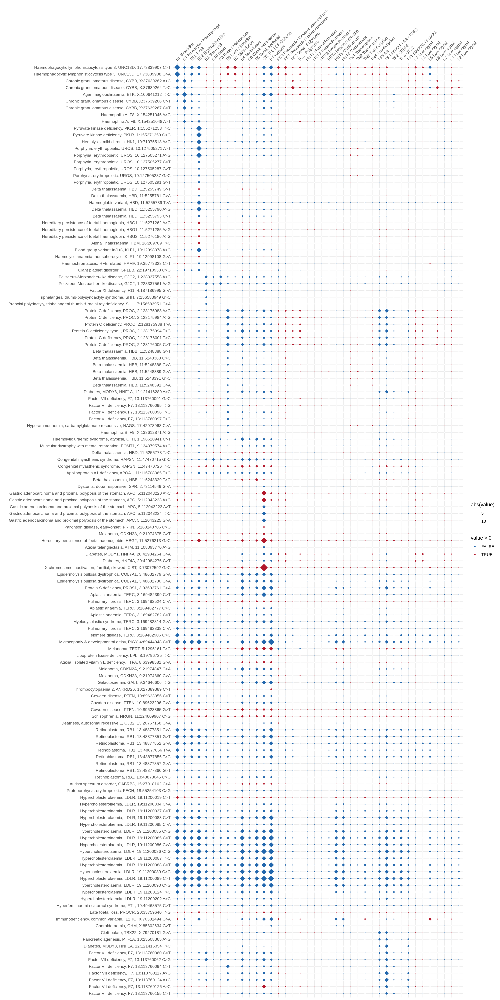

In [69]:

selectinds = abs(anno$diff_C_final)>1.1 
plotdiffs =  altproj[selectinds,1:40]-refproj[selectinds,1:40]
colnames(plotdiffs) = as.character(0:39)
anno[,id:=paste(pheno,gene, paste0(chr,':',pos,' ',ref,'>',alt),sep=', '),]
plotdiffs$id = anno[selectinds, id]

plotdata = melt(plotdiffs, id='id')
plotdata = rename(plotdata, c("variable" = "C"))
plotdata$C = as.numeric(as.matrix(plotdata$C))
cnames$label_name = paste(cnames$ID, cnames$name)


options(repr.plot.width = 15, repr.plot.height = 30, repr.plot.res = 200)
plotdata$C = factor( cnames$label_name[match(plotdata$C,cnames$index)], levels=cnames$label_name)
plotdata$id = factor(plotdata$id, levels=plotdiffs$id[rev(order(match(anno$C_final[selectinds], cnames$index)))])
ggplot(plotdata)+geom_point(aes(x=C,y=id, size=abs(value),fill=value>0),color='white',shape=23)+scale_fill_manual(values=c('#2166ac','#b2182b'))+
    theme_minimal()+ scale_size_area()+xlab('')+ylab('')+
    theme(axis.text.x = element_text(angle = 45, vjust = 0, hjust=0))+scale_x_discrete(position = c("top")) #
#ggsave('./figures/hgmd.highpredictions.matrix.pdf',  width=15, height = 30, dpi = 200, device=cairo_pdf)